람다=10

In [1]:
import sys
!{sys.executable} -m pip install torchscan torchsummary

In [2]:
import argparse
import os
import random
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as vdatasets
import torchvision.transforms as T
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import pandas as pd

from IPython.display import HTML

from torchscan import summary
# from torchsummary import summary

import tqdm
from tqdm.notebook import tqdm as tqdm_nb

import warnings
warnings.filterwarnings("ignore")


manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


# Source code

based on [PyTorch DCGAN Tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)

In [3]:
dataroot = "/home/NAS_mount2/jwkim/data"
workers = 16
batch_size = 128
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 100
lr = 0.0001
lambda_gp = 10
beta1 = 0.0
beta2 = 0.9
ngpu = 1

# CelebA Dataset

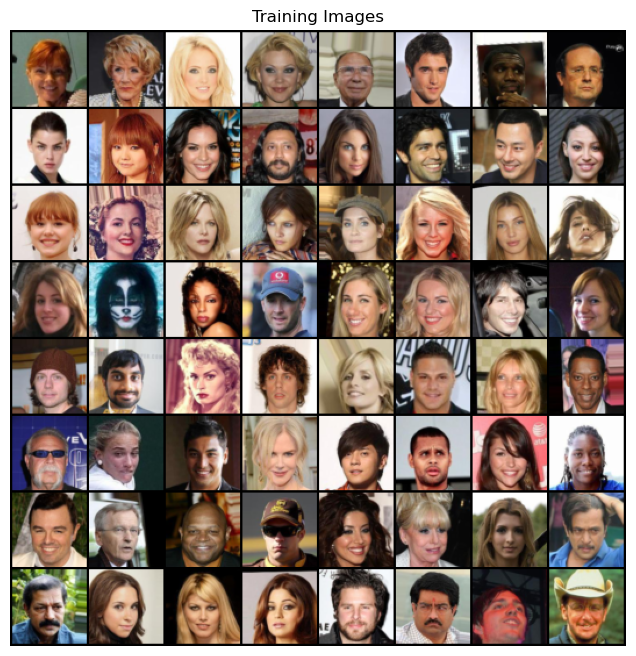

In [4]:
dataset = vdatasets.ImageFolder(root=dataroot,
                                transform=T.Compose([
                                    T.Resize(image_size),
                                    T.CenterCrop(image_size),
                                    T.ToTensor(),
                                    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device('cuda:4' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')

one_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(one_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
# plt.show()

# Utils

In [5]:
# custom weights initialization called on netG and netD
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
class SaveCheckpoint:
    def __init__(self, path = None):
        self.loss = np.inf
        self.path = path or os.path.join('.')
    
    def update(self, model, loss):
        if self.loss > loss:
            self.loss = loss
            self.save(model)

    def save(self, model, name):
        if isinstance(model, nn.Module):
            model = [model]
            name = [name]
        for m, n in zip(model, name):
            torch.save(m.state_dict(), '{}/{}.pth'.format(self.path, n))

# Define Models

In [7]:
# Generator Code

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(nz, 128),
            nn.BatchNorm1d(128, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(128, 256),
            nn.BatchNorm1d(256, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(256, 512),
            nn.BatchNorm1d(512, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(512, 1024),
            nn.BatchNorm1d(1024, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(1024, nc * image_size * image_size),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.shape[0], nc, image_size, image_size)
        return img

In [8]:
# Create the generator
netG = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
# netG.apply(weights_init)

# Print the model
# summary(netG, (batch_size, nz))
print(netG)

Generator(
  (model): Sequential(
    (0): Linear(in_features=100, out_features=128, bias=True)
    (1): BatchNorm1d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Linear(in_features=128, out_features=256, bias=True)
    (4): BatchNorm1d(256, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Linear(in_features=256, out_features=512, bias=True)
    (7): BatchNorm1d(512, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Linear(in_features=512, out_features=1024, bias=True)
    (10): BatchNorm1d(1024, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Linear(in_features=1024, out_features=12288, bias=True)
    (13): Tanh()
  )
)


In [9]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(nc * image_size * image_size, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
        )

    def forward(self, img):
        img_flat = img.view(img.shape[0], -1)
        validity = self.model(img_flat)
        return validity


In [10]:
# Create the Discriminator
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
# netD.apply(weights_init)

# Print the model
# summary(netD, (3, 64, 64))
print(netD)

Discriminator(
  (model): Sequential(
    (0): Linear(in_features=12288, out_features=512, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Linear(in_features=512, out_features=256, bias=True)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)


In [11]:
# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, device=device)

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))

# Gradient Penalty

In [12]:
from torch import autograd
from torch.autograd import Variable

Tensor = torch.cuda.FloatTensor

lambda_gp = 10

In [13]:
from torch import autograd

def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    alpha = torch.randn(real_samples.size(0), 1, 1, 1, device=device)
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    d_interpolates = D(interpolates)
    fake = torch.ones(real_samples.shape[0], 1, device=device)
    # Get gradient w.r.t. interpolates
    gradients = autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty

# Train Loop

In [14]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

total_steps = num_epochs * len(dataloader)
fig_save_interval = total_steps // 30   # animation can contain max 36 images

pbar = tqdm_nb()
piter = 0

checkpoint = SaveCheckpoint()

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    epoch_steps = len(dataloader)
    pbar.reset(total=epoch_steps)
    for i, data in enumerate(dataloader, 0):
        pbar.update()
        piter += 1
        ################################################################
        # (1) Update D network
        ################################################################
        netD.zero_grad()
        
        real_imgs = data[0].float().to(device)
        b_size = data[0].shape[0]
        noise = torch.randn(b_size, nz, device=device)
        fake_imgs = netG(noise)

        # Gradient penalty
        gp = compute_gradient_penalty(netD, real_imgs.data, fake_imgs.data)
        
        # Adversarial loss
        errD = -torch.mean(netD(real_imgs)) + torch.mean(netD(fake_imgs)) + lambda_gp * gp
        errD.backward()
        optimizerD.step()
        
        # Train Generator for every 5 steps
        if i % 5 == 0:
            ################################################################
            # (2) Update G network
            ################################################################
            netG.zero_grad()

            gen_img = netG(noise)
            errG = -torch.mean(netD(gen_img))
            errG.backward()
            optimizerG.step()

            # Output training stats
            desc = '[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' \
                    % (epoch+1, num_epochs, i, epoch_steps, errD.item(), errG.item())
            pbar.set_description(desc)

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (piter - 1) % fig_save_interval == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append((epoch+1, i, vutils.make_grid(fake, padding=2, normalize=True)))
            print(desc)

pbar.refresh()

checkpoint.save([netG, netD], ['WGAN-GP_netG', 'CWGAN-GP_netD'])

0it [00:00, ?it/s]

Starting Training Loop...
[1/100][0/778] Loss_D: 8.1946 Loss_G: 0.0553
[4/100][255/778] Loss_D: -27.0667 Loss_G: 10.9876
[7/100][515/778] Loss_D: -21.4124 Loss_G: 2.1107
[10/100][775/778] Loss_D: -16.9601 Loss_G: 4.3734
[14/100][255/778] Loss_D: -14.8852 Loss_G: 7.2446
[17/100][515/778] Loss_D: -14.2128 Loss_G: 3.4917
[20/100][775/778] Loss_D: -11.9868 Loss_G: 7.8824
[24/100][255/778] Loss_D: -11.9868 Loss_G: 6.1316
[27/100][515/778] Loss_D: -10.6857 Loss_G: 2.5087
[30/100][775/778] Loss_D: -9.3963 Loss_G: 9.8015
[34/100][255/778] Loss_D: -7.5983 Loss_G: 3.4723
[37/100][515/778] Loss_D: -8.0072 Loss_G: -0.1808
[40/100][770/778] Loss_D: -8.5723 Loss_G: 2.3034
[44/100][255/778] Loss_D: -8.3717 Loss_G: 3.6370
[47/100][510/778] Loss_D: -8.1660 Loss_G: 1.9224
[50/100][770/778] Loss_D: -7.3106 Loss_G: 3.5913
[54/100][250/778] Loss_D: -5.3537 Loss_G: 5.9246
[57/100][510/778] Loss_D: -6.8405 Loss_G: -0.2679
[60/100][770/778] Loss_D: -7.0364 Loss_G: 4.2645
[64/100][250/778] Loss_D: -6.8022 Loss

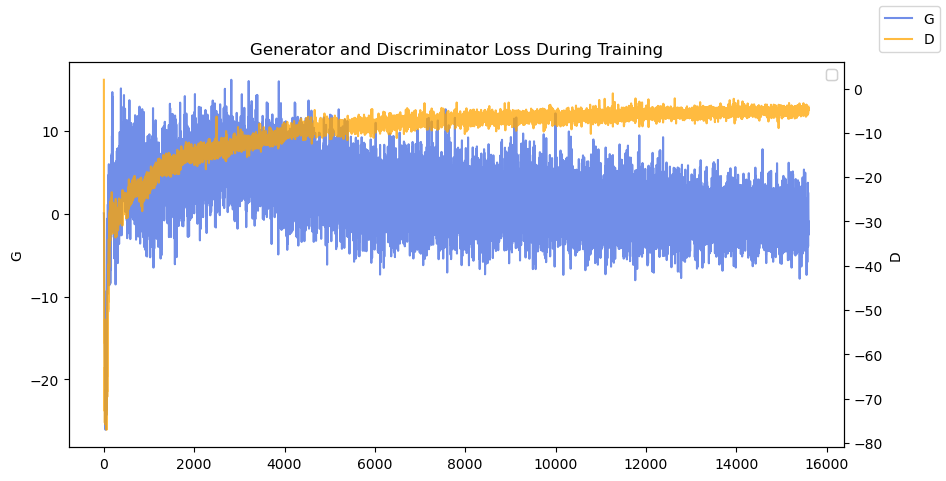

In [15]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({'G': G_losses[1:], 'D': D_losses[1:]})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

Animation size has reached 21204525 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


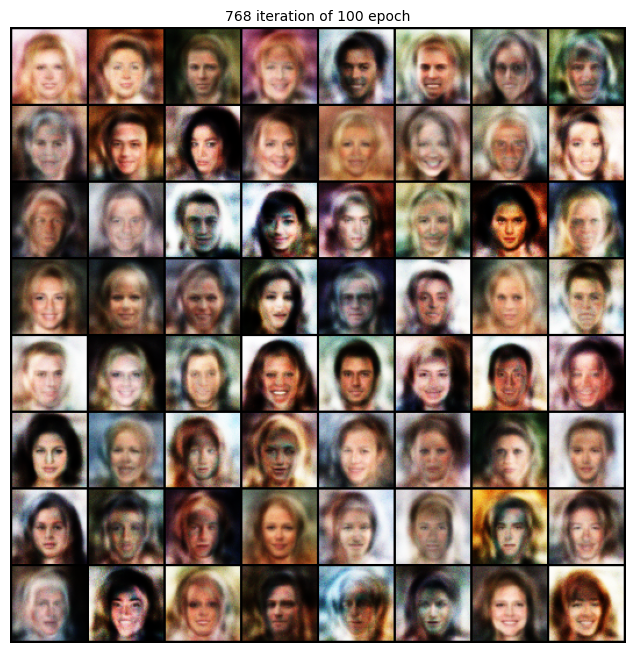

In [16]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
plt.axis('off')
imgs = [[
    plt.imshow(np.transpose(img, (1,2,0)), animated=True),
    plt.text(0.5, 1.01, f'{step} iteration of {epoch} epoch', horizontalalignment='center', transform=ax.transAxes),
] for epoch, step, img in img_list]

ani = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())